In [1]:
from matplotlib import pyplot as plt
from PIL import Image
import torchvision
import numpy as np
import shutil
import random
import torch
import os

%matplotlib inline

torch.manual_seed(0)

print('Using PyTorch version', torch.__version__)

Using PyTorch version 1.9.0


In [2]:
class_names = ['normal', 'viral', 'covid']
root_dir    = 'COVID-19 Radiography Database'
source_dirs = ['normal', 'viral', 'covid']
values = [3058, 403, 1085]

if os.path.isdir(os.path.join(root_dir, source_dirs[1])):
    os.mkdir(os.path.join(root_dir, 'test'))

    for i, d in enumerate(source_dirs):
        os.rename(os.path.join(root_dir, d), os.path.join(root_dir, class_names[i]))

    for c in class_names:
        os.mkdir(os.path.join(root_dir, 'test', c))
    x=0
    for c in class_names:
        images = [x for x in os.listdir(os.path.join(root_dir, c)) if x.lower().endswith('png')]
        selected_images = random.sample(images, values[x])
        x+=1
        for image in selected_images:
            source_path = os.path.join(root_dir, c, image)
            target_path = os.path.join(root_dir, 'test', c, image)
            shutil.move(source_path, target_path)

In [3]:
class ChestXRayDataset(torch.utils.data.Dataset):
    def __init__(self, image_dirs, transform):
        def get_images(class_name): 
            images = [x for x in os.listdir(image_dirs[class_name]) if x.lower().endswith('png')] 
            print(f'Found {len(images)} {class_name} examples')
            return images
        
        self.images = {}
        self.class_names = ['normal', 'viral', 'covid']
        
        for c in self.class_names:
            self.images[c] = get_images(c)
            
        self.image_dirs = image_dirs
        self.transform = transform
          
    def __len__(self):
        return sum([len(self.images[c]) for c in self.class_names])
    
    def __getitem__(self, index):
        class_name = random.choice(self.class_names)
        index = index%len(self.images[class_name])
        image_name = self.images[class_name][index]
        image_path = os.path.join(self.image_dirs[class_name], image_name)
        image = Image.open(image_path).convert('RGB')
        return self.transform(image), self.class_names.index(class_name)

In [4]:
train_transform = torchvision.transforms.Compose([
    torchvision.transforms.Resize(size = (224, 224)),
    torchvision.transforms.RandomHorizontalFlip(),
    torchvision.transforms.ToTensor(),
    torchvision.transforms.Normalize(mean = [0.485, 0.456, 0.406], std = [0.229, 0.224, 0.225])
])

In [5]:
test_transform = torchvision.transforms.Compose([
    torchvision.transforms.Resize(size = (224, 224)),
    torchvision.transforms.ToTensor(),
    torchvision.transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

In [6]:
train_dirs = {
    'normal': 'COVID-19 Radiography Database/normal',
    'viral': 'COVID-19 Radiography Database/viral',
    'covid': 'COVID-19 Radiography Database/covid'
}

In [7]:
train_dataset = ChestXRayDataset(train_dirs, train_transform)

Found 7134 normal examples
Found 942 viral examples
Found 2531 covid examples


In [8]:
test_dirs = {
    'normal': 'COVID-19 Radiography Database/test/normal',
    'viral': 'COVID-19 Radiography Database/test/viral',
    'covid': 'COVID-19 Radiography Database/test/covid'
}

In [9]:
test_dataset = ChestXRayDataset(test_dirs, test_transform)

Found 3058 normal examples
Found 403 viral examples
Found 1085 covid examples


In [10]:
batch_size = 6

dl_train = torch.utils.data.DataLoader(train_dataset, batch_size = batch_size, shuffle = True)
dl_test = torch.utils.data.DataLoader(test_dataset, batch_size = batch_size, shuffle = True)

print('Number of training batches', len(dl_train))
print('Number of test batches', len(dl_test))

Number of training batches 1768
Number of test batches 758


In [11]:
class_names = train_dataset.class_names

def show_images(images, labels, preds):
    plt.figure(figsize=(16, 9))
    for i, image in enumerate(images):
        plt.subplot(1, 6, i + 1, xticks = [], yticks = [])
        image = image.numpy().transpose((1, 2, 0))
        mean  = np.array([0.485, 0.456, 0.406])
        std   = np.array([0.229, 0.224, 0.225])
        image = image*std + mean
        image = np.clip(image, 0., 1.)
        plt.imshow(image)
        col   = 'green'
        if preds[i] != labels[i]:
            col = 'red'
            
        plt.xlabel(f'{class_names[int(labels[i].numpy())]}')
        plt.ylabel(f'{class_names[int(preds[i].numpy())]}', color = col)
    plt.tight_layout()
    plt.show()

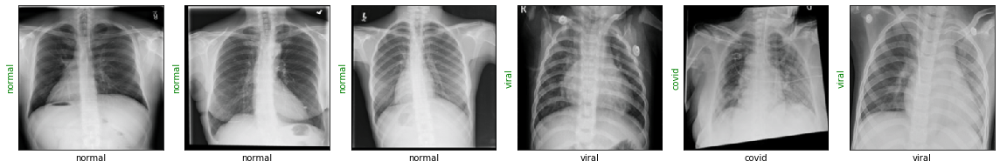

In [12]:
images, labels = next(iter(dl_train))
show_images(images, labels, labels)

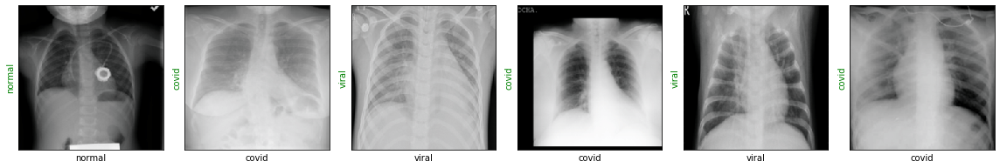

In [13]:
images, labels = next(iter(dl_test))
show_images(images, labels, labels)

In [14]:
resnet18 = torchvision.models.resnet18(pretrained = True)

#print(resnet18)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [15]:
resnet18.fc = torch.nn.Linear(in_features = 512, out_features = 3)
loss_fn     = torch.nn.CrossEntropyLoss()
optimizer   = torch.optim.Adam(resnet18.parameters(), lr = 3e-5)

In [16]:
def show_preds():
    resnet18.eval()
    images, labels = next(iter(dl_test))
    print(type(images))
    print(type(labels))
    print(images.shape)
    outputs  = resnet18(images)
    _, preds = torch.max(outputs, 1)
    show_images(images, labels, preds)

<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


D:\Anaconda\lib\site-packages\torch\nn\functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  ..\c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


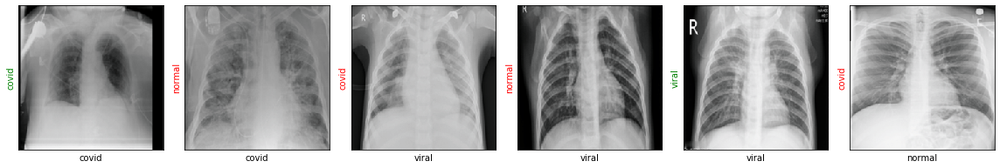

In [17]:
show_preds()

In [23]:
def train(epochs):
    print('Starting training..')
    for e in range(0, epochs):
        print('='*20)
        print(f'Starting epoch {e + 1}/{epochs}')
        print('='*20)

        train_loss = 0.
        val_loss = 0.

        resnet18.train() # set model to training phase

        for train_step, (images, labels) in enumerate(dl_train):
            optimizer.zero_grad()
            outputs = resnet18(images)
            loss = loss_fn(outputs, labels)
            loss.backward()
            optimizer.step()
            train_loss += loss.item()
            if train_step % 20 == 0:
                print('Evaluating at step', train_step)

                accuracy = 0

                resnet18.eval() # set model to eval phase

                for val_step, (images, labels) in enumerate(dl_test):
                    outputs = resnet18(images)
                    loss = loss_fn(outputs, labels)
                    val_loss += loss.item()

                    _, preds = torch.max(outputs, 1)
                    accuracy += sum((preds == labels).numpy())

                val_loss /= (val_step + 1)
                accuracy = accuracy/len(test_dataset)
                print("Accuracy = {}".format(accuracy))
                print(f'Validation Loss: {val_loss:.4f}, Accuracy: {accuracy:.4f}')

                show_preds()

                resnet18.train()

                if accuracy >= 0.98:
                    print('Performance condition satisfied, stopping..')
                    return

        train_loss /= (train_step + 1)

        print(f'Training Loss: {train_loss:.4f}')
    print('Training complete..')

Starting training..
Starting epoch 1/1
Evaluating at step 0
Accuracy = 0.6656401231852178
Validation Loss: 0.7547, Accuracy: 0.6656
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


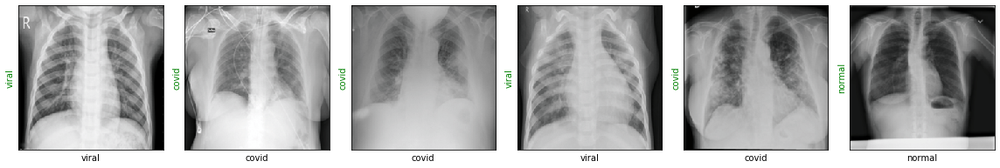

Evaluating at step 20
Accuracy = 0.8660360756709194
Validation Loss: 0.4481, Accuracy: 0.8660
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


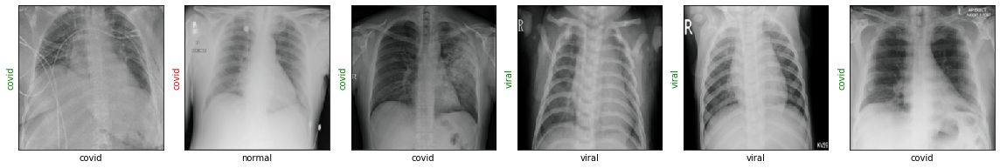

Evaluating at step 40
Accuracy = 0.8717553893532776
Validation Loss: 0.3361, Accuracy: 0.8718
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


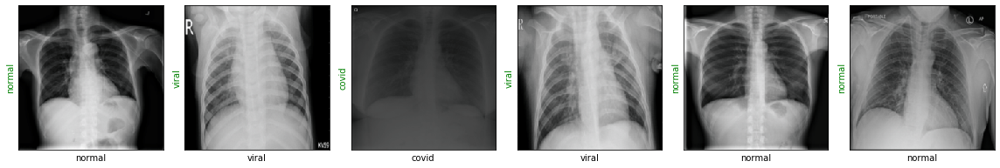

Evaluating at step 60
Accuracy = 0.8933128024637044
Validation Loss: 0.2856, Accuracy: 0.8933
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


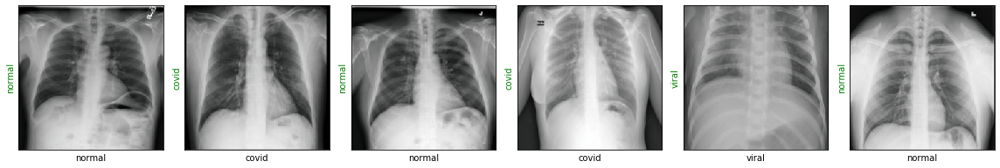

Evaluating at step 80
Accuracy = 0.8880334359876815
Validation Loss: 0.2782, Accuracy: 0.8880
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


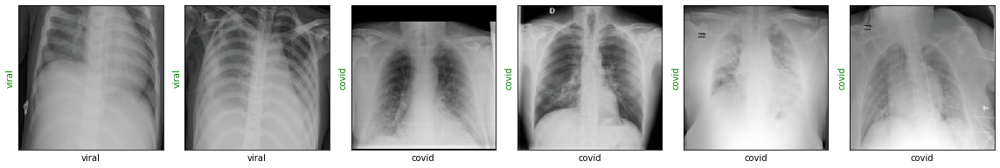

Evaluating at step 100
Accuracy = 0.9175098988121425
Validation Loss: 0.2232, Accuracy: 0.9175
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


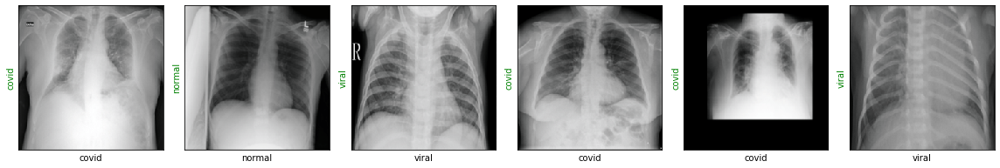

Evaluating at step 120
Accuracy = 0.9300483941926969
Validation Loss: 0.2094, Accuracy: 0.9300
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


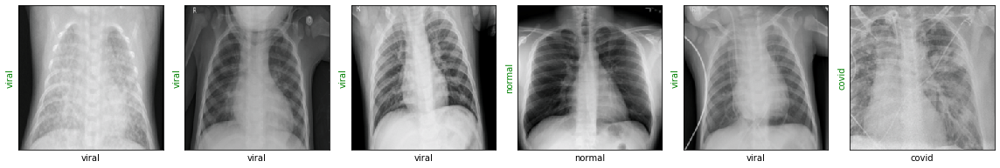

Evaluating at step 140
Accuracy = 0.921909370875495
Validation Loss: 0.2212, Accuracy: 0.9219
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


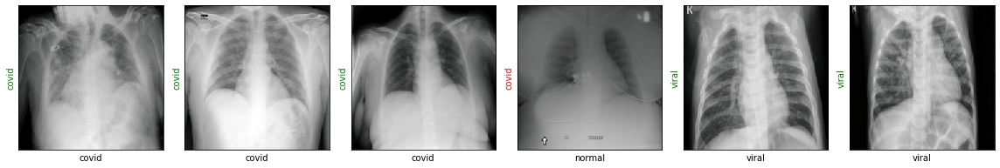

Evaluating at step 160
Accuracy = 0.9375274967003959
Validation Loss: 0.1928, Accuracy: 0.9375
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


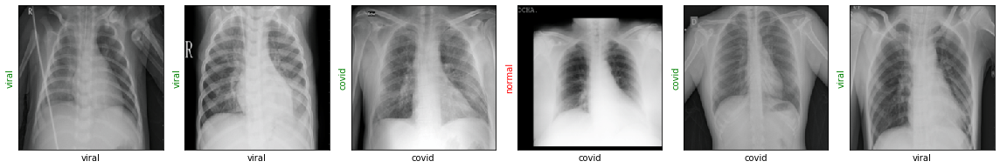

Evaluating at step 180
Accuracy = 0.9326880774307084
Validation Loss: 0.1995, Accuracy: 0.9327
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


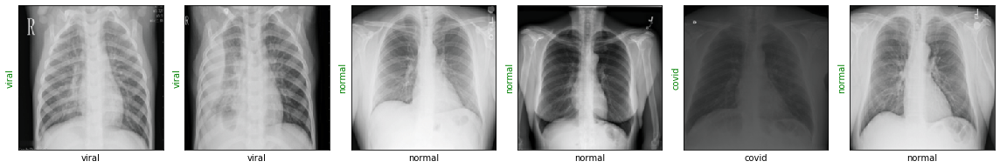

Evaluating at step 200
Accuracy = 0.9476462824461065
Validation Loss: 0.1587, Accuracy: 0.9476
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


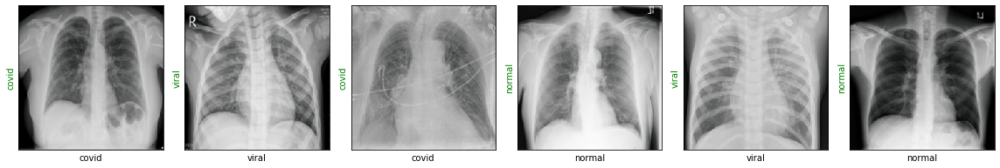

Evaluating at step 220
Accuracy = 0.9258688957325121
Validation Loss: 0.1915, Accuracy: 0.9259
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


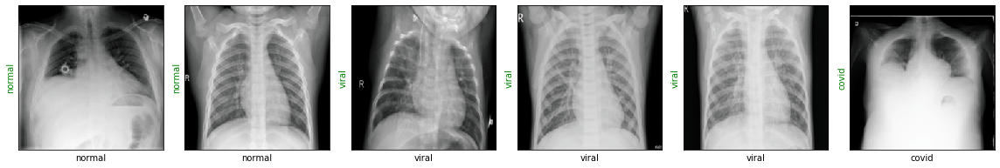

Evaluating at step 240
Accuracy = 0.9188297404311483
Validation Loss: 0.2145, Accuracy: 0.9188
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


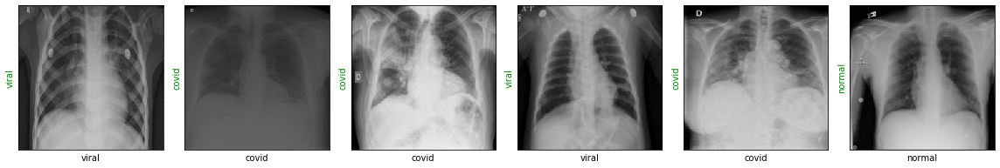

Evaluating at step 260
Accuracy = 0.9505059392872856
Validation Loss: 0.1464, Accuracy: 0.9505
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


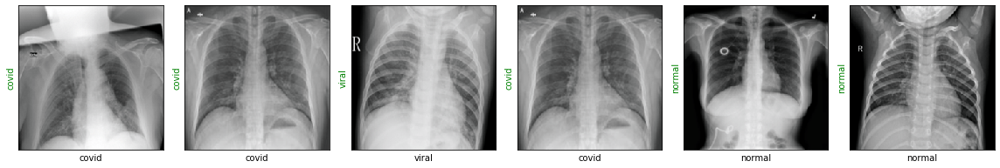

Evaluating at step 280
Accuracy = 0.9586449626044875
Validation Loss: 0.1417, Accuracy: 0.9586
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


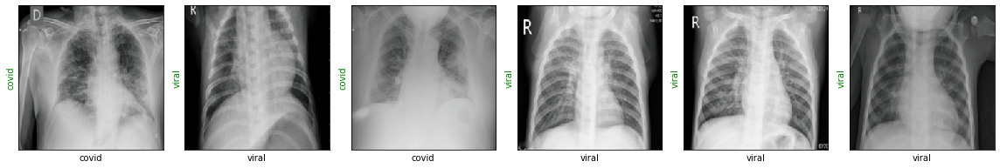

Evaluating at step 300
Accuracy = 0.9386273647162341
Validation Loss: 0.1695, Accuracy: 0.9386
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


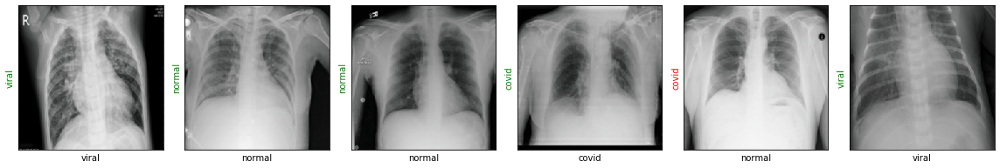

Evaluating at step 320
Accuracy = 0.9502859656841179
Validation Loss: 0.1343, Accuracy: 0.9503
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


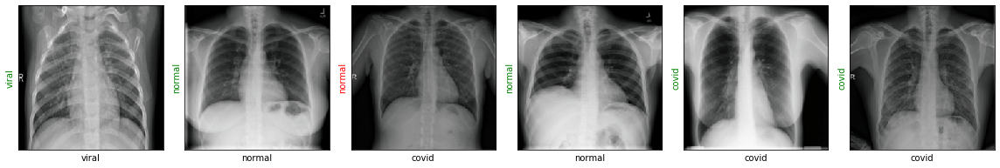

Evaluating at step 340
Accuracy = 0.960624725032996
Validation Loss: 0.1278, Accuracy: 0.9606
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


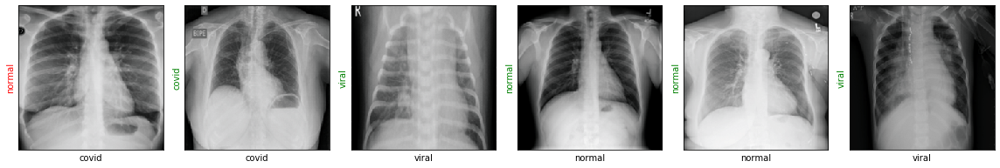

Evaluating at step 360
Accuracy = 0.9599648042234932
Validation Loss: 0.1232, Accuracy: 0.9600
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


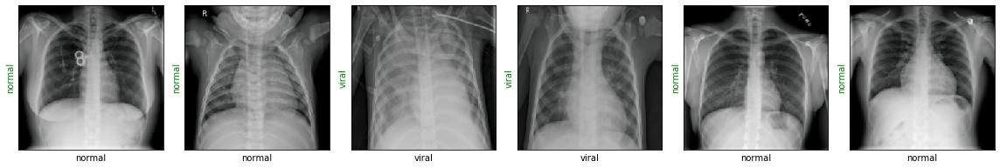

Evaluating at step 380
Accuracy = 0.9511658600967884
Validation Loss: 0.1363, Accuracy: 0.9512
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


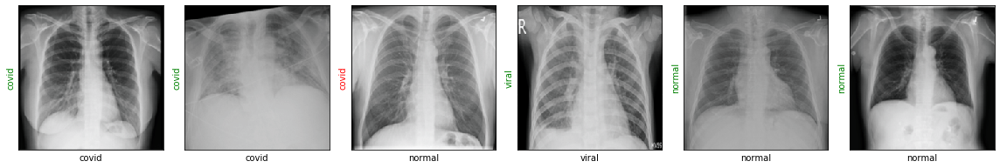

Evaluating at step 400
Accuracy = 0.9557853057633084
Validation Loss: 0.1265, Accuracy: 0.9558
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


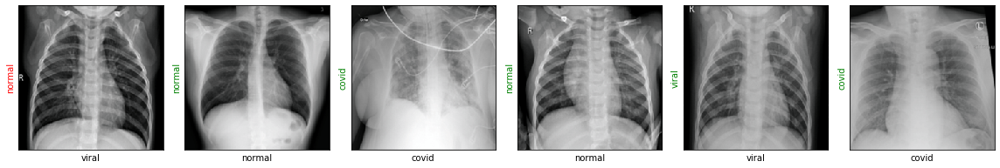

Evaluating at step 420
Accuracy = 0.9509458864936208
Validation Loss: 0.1433, Accuracy: 0.9509
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


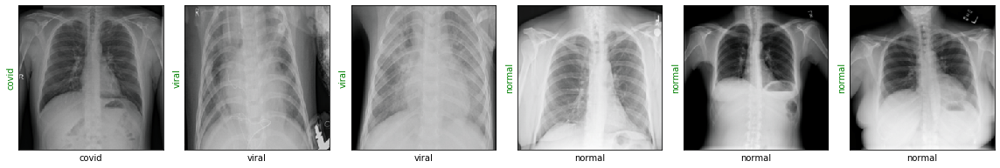

Evaluating at step 440
Accuracy = 0.9106907171139463
Validation Loss: 0.2174, Accuracy: 0.9107
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


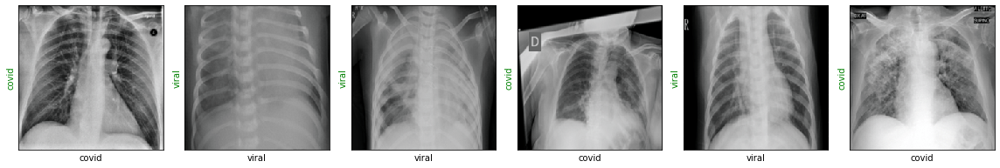

Evaluating at step 460
Accuracy = 0.9665640123185217
Validation Loss: 0.1143, Accuracy: 0.9666
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


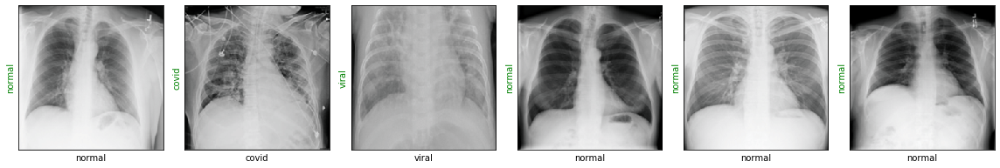

Evaluating at step 480
Accuracy = 0.9263088429388473
Validation Loss: 0.1746, Accuracy: 0.9263
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


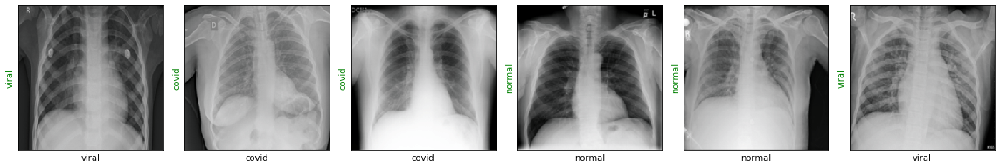

Evaluating at step 500
Accuracy = 0.9568851737791465
Validation Loss: 0.1239, Accuracy: 0.9569
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


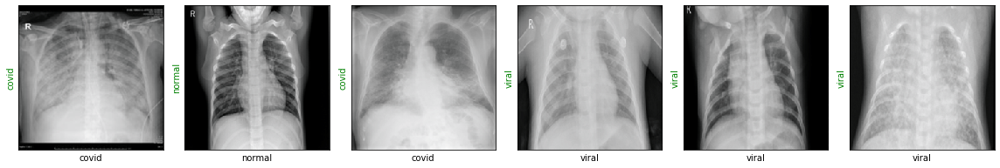

Evaluating at step 520
Accuracy = 0.9342278926528816
Validation Loss: 0.1660, Accuracy: 0.9342
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


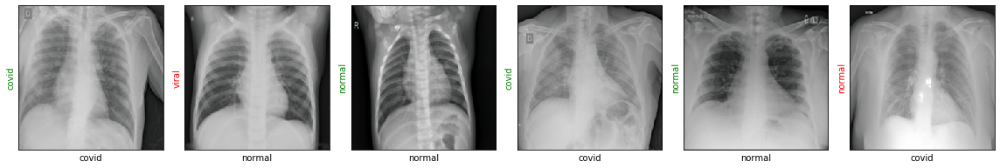

Evaluating at step 540
Accuracy = 0.9529256489221294
Validation Loss: 0.1281, Accuracy: 0.9529
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


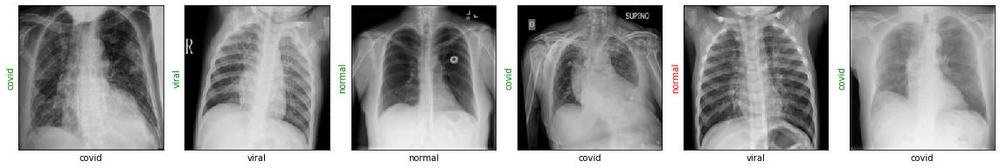

Evaluating at step 560
Accuracy = 0.9656841179058513
Validation Loss: 0.1116, Accuracy: 0.9657
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


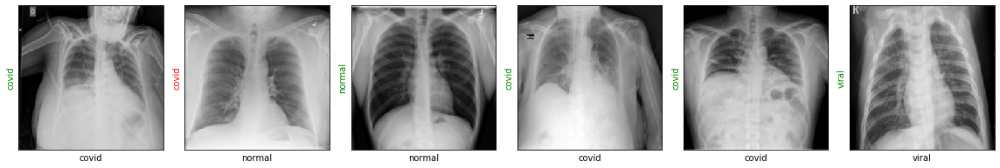

Evaluating at step 580
Accuracy = 0.9648042234931808
Validation Loss: 0.1084, Accuracy: 0.9648
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


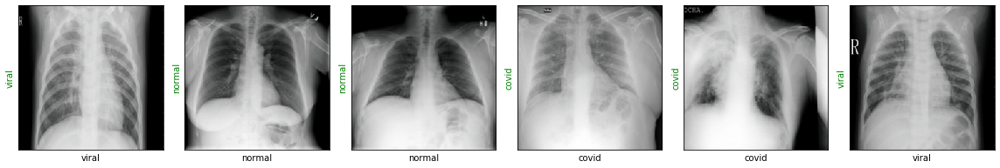

Evaluating at step 600
Accuracy = 0.9546854377474703
Validation Loss: 0.1194, Accuracy: 0.9547
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


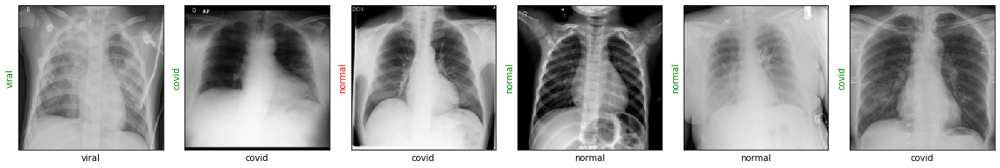

Evaluating at step 620
Accuracy = 0.9617245930488342
Validation Loss: 0.1034, Accuracy: 0.9617
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


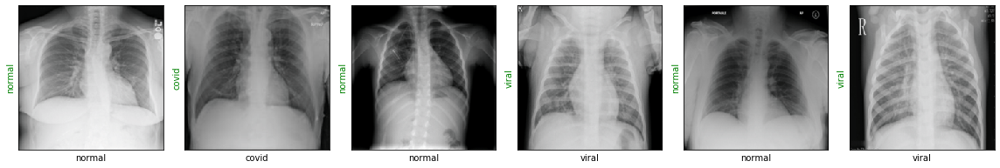

Evaluating at step 640
Accuracy = 0.9656841179058513
Validation Loss: 0.0936, Accuracy: 0.9657
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


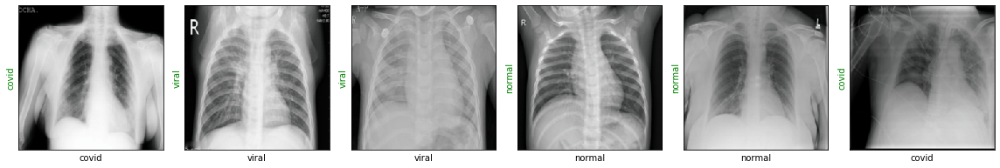

Evaluating at step 660
Accuracy = 0.9564452265728113
Validation Loss: 0.1110, Accuracy: 0.9564
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


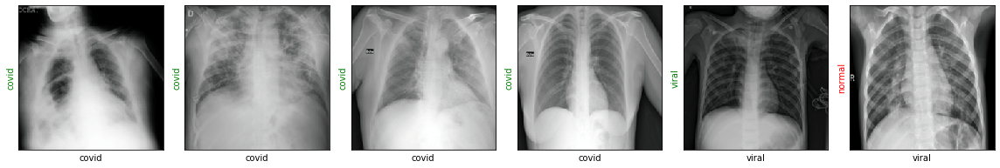

Evaluating at step 680
Accuracy = 0.9700835899692037
Validation Loss: 0.0929, Accuracy: 0.9701
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


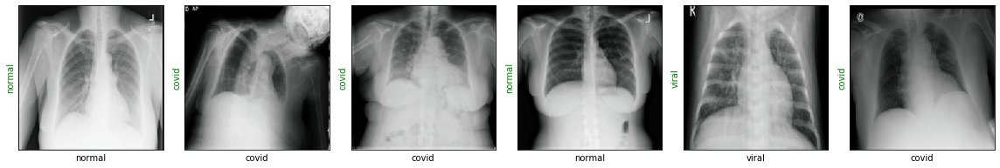

Evaluating at step 700
Accuracy = 0.9654641443026837
Validation Loss: 0.0973, Accuracy: 0.9655
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


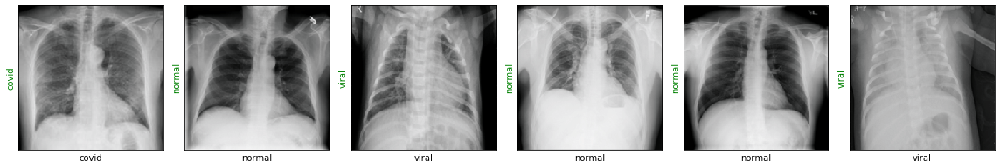

Evaluating at step 720
Accuracy = 0.9749230092388913
Validation Loss: 0.0790, Accuracy: 0.9749
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


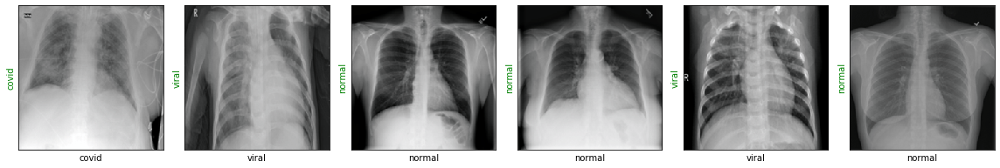

Evaluating at step 740
Accuracy = 0.9604047514298284
Validation Loss: 0.1018, Accuracy: 0.9604
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


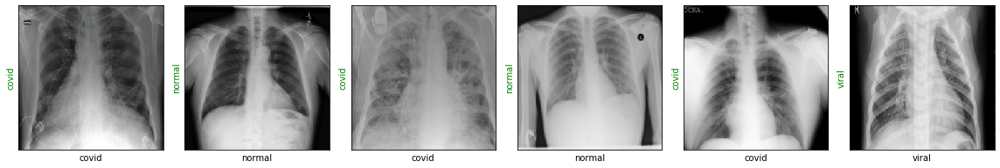

Evaluating at step 760
Accuracy = 0.9685437747470304
Validation Loss: 0.0926, Accuracy: 0.9685
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


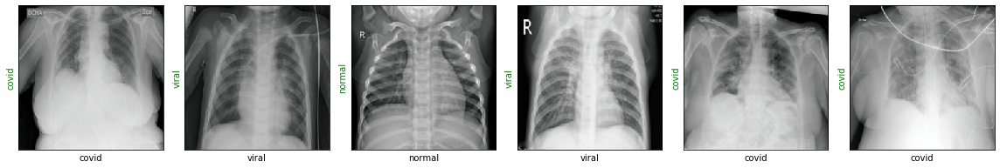

Evaluating at step 780
Accuracy = 0.9608446986361636
Validation Loss: 0.1042, Accuracy: 0.9608
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


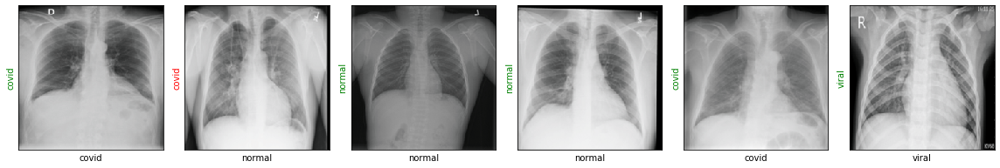

Evaluating at step 800
Accuracy = 0.9771227452705675
Validation Loss: 0.0719, Accuracy: 0.9771
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


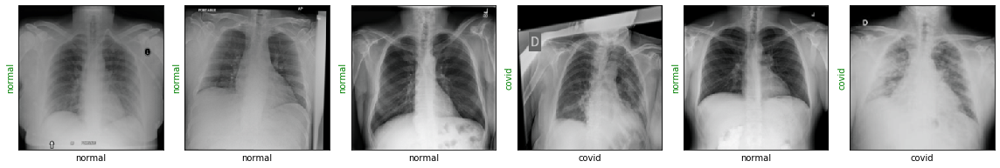

Evaluating at step 820
Accuracy = 0.9782226132864056
Validation Loss: 0.0732, Accuracy: 0.9782
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


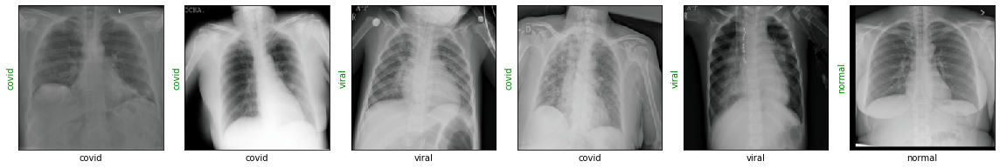

Evaluating at step 840
Accuracy = 0.9771227452705675
Validation Loss: 0.0772, Accuracy: 0.9771
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


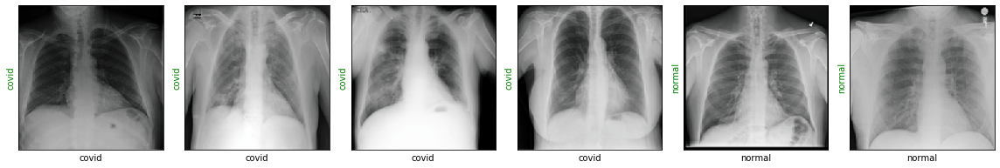

Evaluating at step 860
Accuracy = 0.9773427188737351
Validation Loss: 0.0710, Accuracy: 0.9773
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


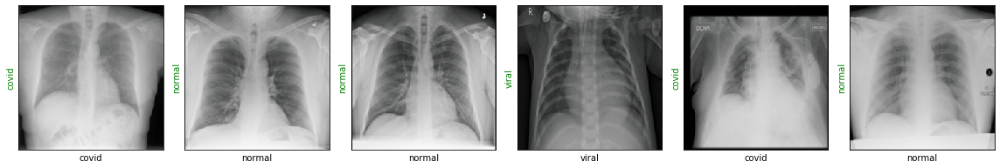

Evaluating at step 880
Accuracy = 0.9729432468103828
Validation Loss: 0.0807, Accuracy: 0.9729
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


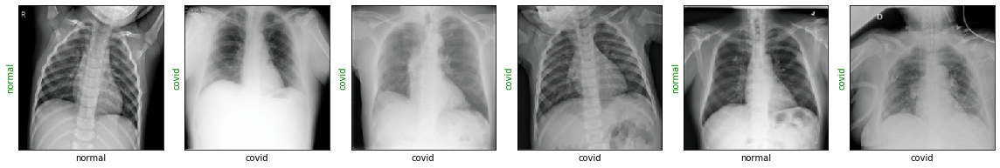

Evaluating at step 900
Accuracy = 0.9760228772547295
Validation Loss: 0.0739, Accuracy: 0.9760
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


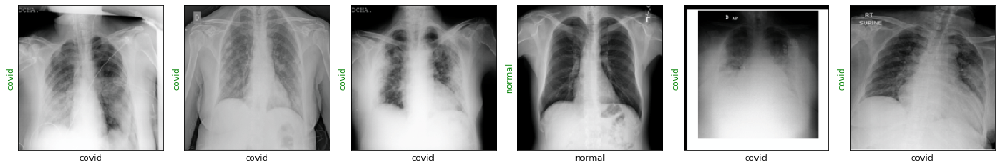

Evaluating at step 920
Accuracy = 0.9736031676198856
Validation Loss: 0.0787, Accuracy: 0.9736
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


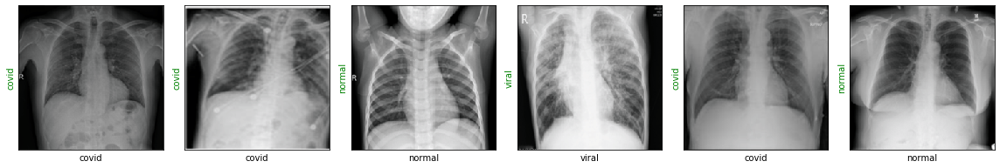

Evaluating at step 940
Accuracy = 0.9676638803343599
Validation Loss: 0.0949, Accuracy: 0.9677
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


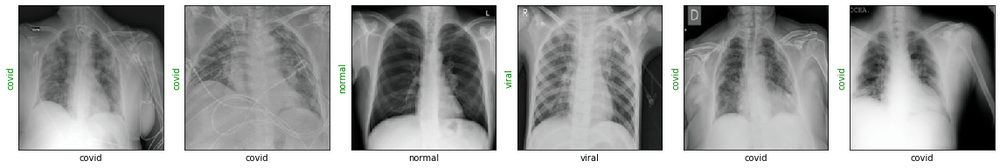

Evaluating at step 960
Accuracy = 0.9729432468103828
Validation Loss: 0.0887, Accuracy: 0.9729
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


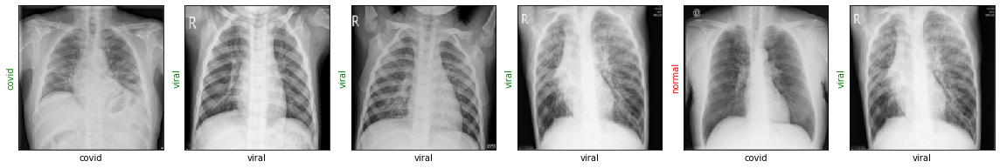

Evaluating at step 980
Accuracy = 0.973383194016718
Validation Loss: 0.0815, Accuracy: 0.9734
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


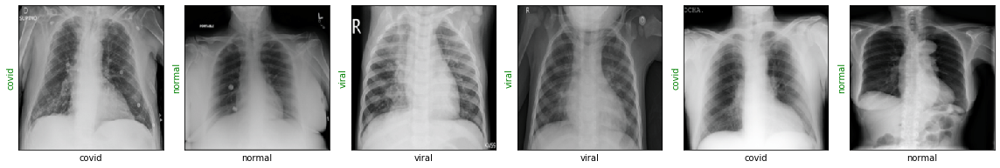

Evaluating at step 1000
Accuracy = 0.9740431148262209
Validation Loss: 0.0902, Accuracy: 0.9740
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


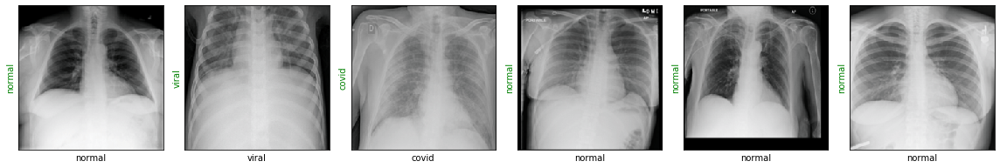

Evaluating at step 1020
Accuracy = 0.9676638803343599
Validation Loss: 0.1001, Accuracy: 0.9677
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


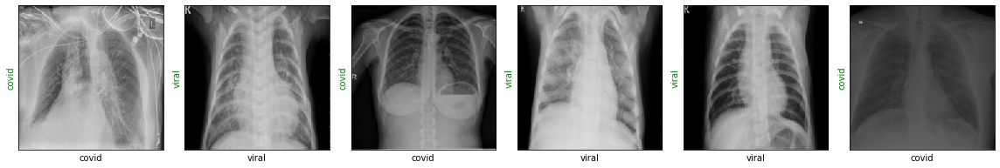

Evaluating at step 1040
Accuracy = 0.968763748350198
Validation Loss: 0.0905, Accuracy: 0.9688
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


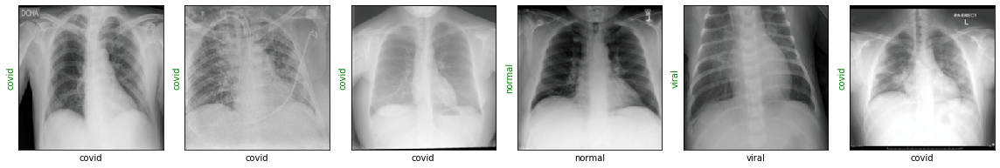

Evaluating at step 1060
Accuracy = 0.9678838539375275
Validation Loss: 0.0843, Accuracy: 0.9679
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


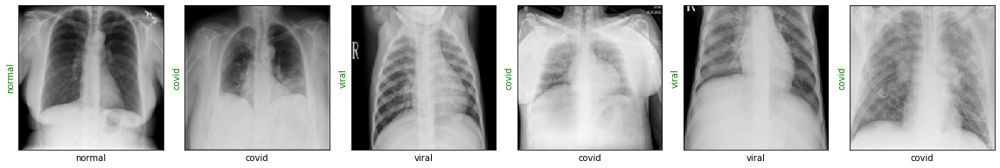

Evaluating at step 1080
Accuracy = 0.9753629564452265
Validation Loss: 0.0767, Accuracy: 0.9754
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


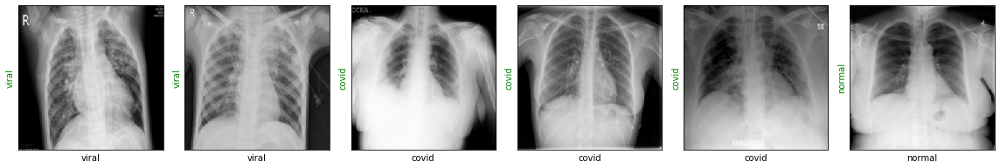

Evaluating at step 1100
Accuracy = 0.9795424549054114
Validation Loss: 0.0635, Accuracy: 0.9795
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


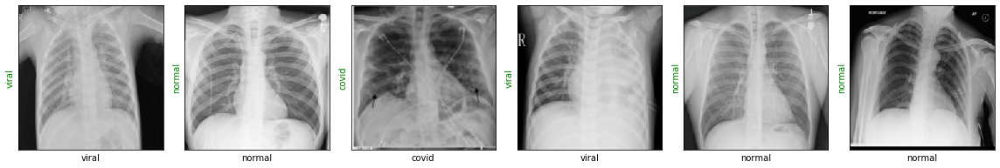

Evaluating at step 1120
Accuracy = 0.9802023757149142
Validation Loss: 0.0636, Accuracy: 0.9802
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


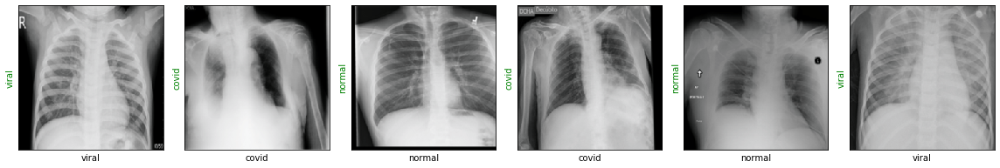

Evaluating at step 1140
Accuracy = 0.9711834579850418
Validation Loss: 0.0827, Accuracy: 0.9712
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


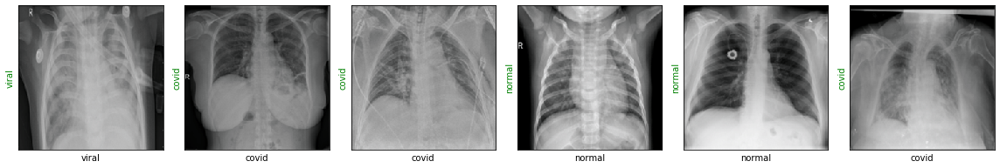

Evaluating at step 1160
Accuracy = 0.9775626924769028
Validation Loss: 0.0693, Accuracy: 0.9776
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


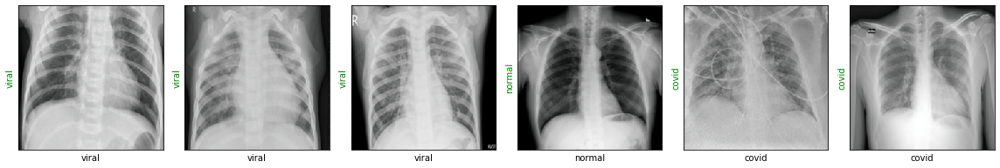

Evaluating at step 1180
Accuracy = 0.9665640123185217
Validation Loss: 0.0864, Accuracy: 0.9666
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


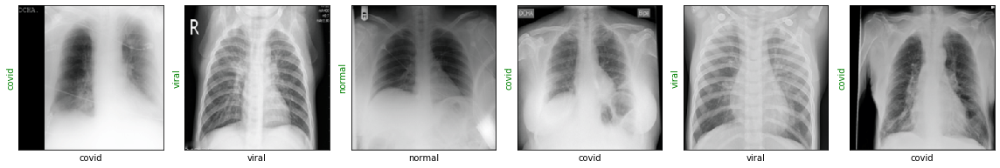

Evaluating at step 1200
Accuracy = 0.973383194016718
Validation Loss: 0.0790, Accuracy: 0.9734
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


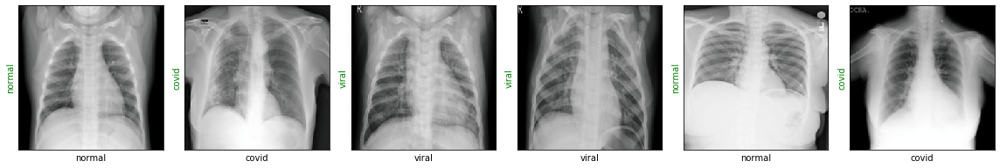

Evaluating at step 1220
Accuracy = 0.9683238011438627
Validation Loss: 0.0848, Accuracy: 0.9683
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


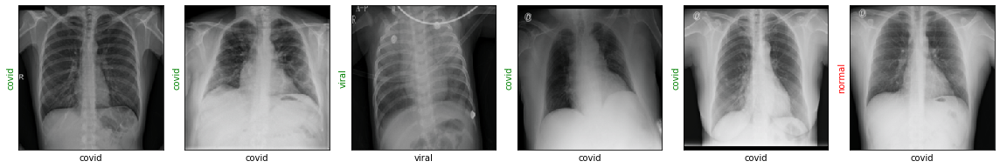

Evaluating at step 1240
Accuracy = 0.9707435107787066
Validation Loss: 0.0838, Accuracy: 0.9707
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


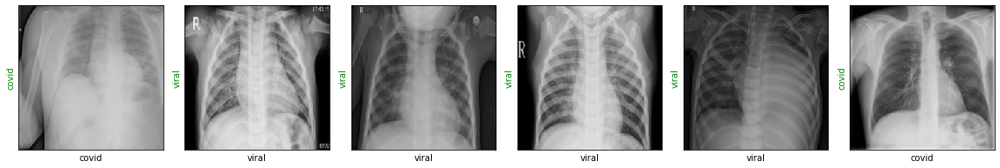

Evaluating at step 1260
Accuracy = 0.9810822701275846
Validation Loss: 0.0682, Accuracy: 0.9811
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


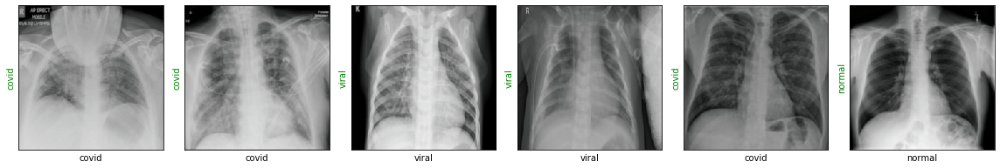

Evaluating at step 1280
Accuracy = 0.9689837219533656
Validation Loss: 0.0879, Accuracy: 0.9690
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


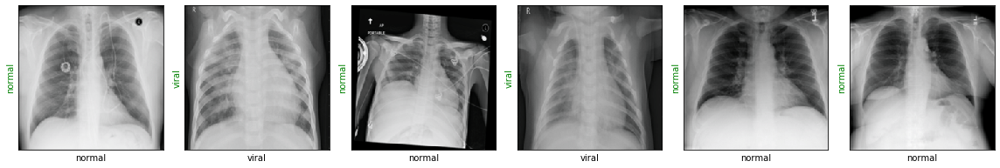

Evaluating at step 1300
Accuracy = 0.9692036955565332
Validation Loss: 0.0838, Accuracy: 0.9692
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


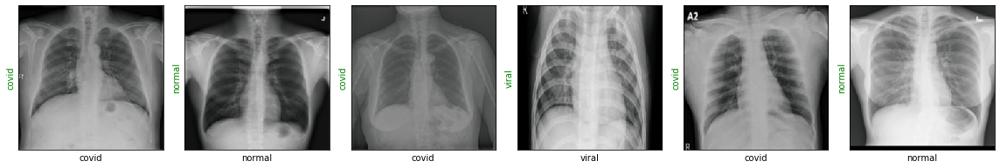

Evaluating at step 1320
Accuracy = 0.9738231412230532
Validation Loss: 0.0794, Accuracy: 0.9738
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


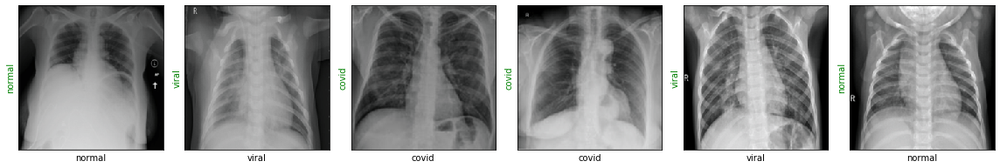

Evaluating at step 1340
Accuracy = 0.9791025076990761
Validation Loss: 0.0647, Accuracy: 0.9791
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


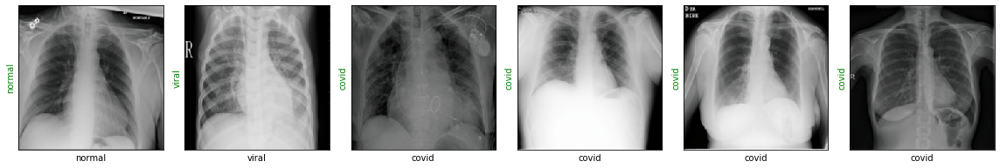

Evaluating at step 1360
Accuracy = 0.9784425868895732
Validation Loss: 0.0703, Accuracy: 0.9784
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


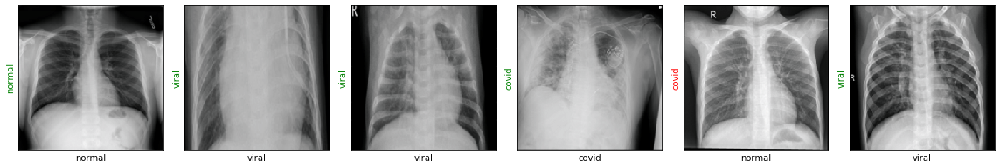

Evaluating at step 1380
Accuracy = 0.9793224813022438
Validation Loss: 0.0710, Accuracy: 0.9793
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


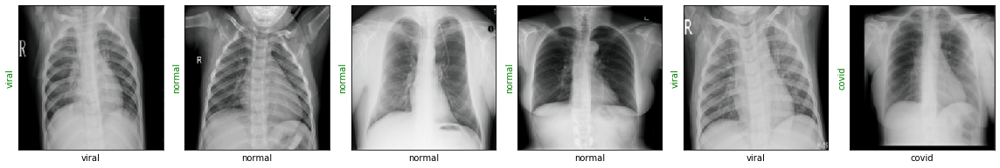

Evaluating at step 1400
Accuracy = 0.9762428508578971
Validation Loss: 0.0731, Accuracy: 0.9762
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


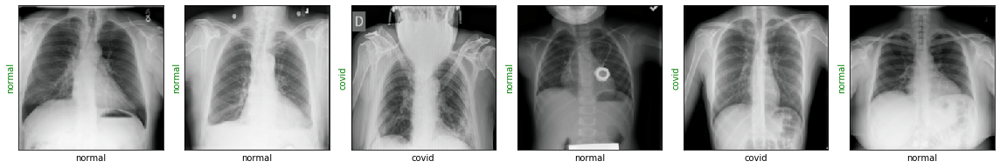

Evaluating at step 1420
Accuracy = 0.9751429828420589
Validation Loss: 0.0782, Accuracy: 0.9751
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


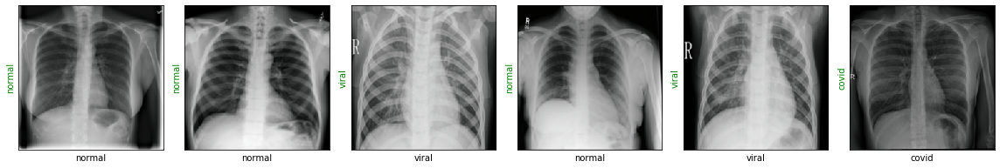

Evaluating at step 1440
Accuracy = 0.9683238011438627
Validation Loss: 0.0945, Accuracy: 0.9683
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


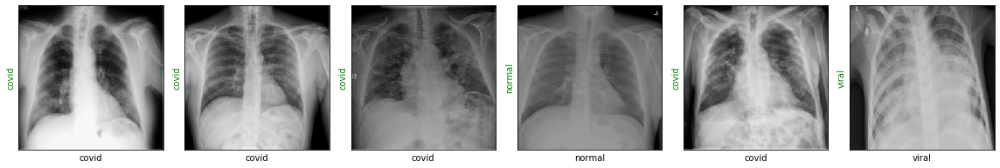

Evaluating at step 1460
Accuracy = 0.9769027716673999
Validation Loss: 0.0728, Accuracy: 0.9769
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


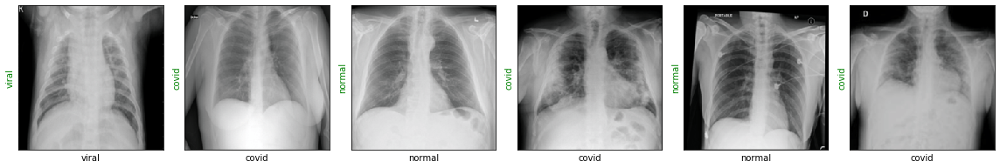

Evaluating at step 1480
Accuracy = 0.9755829300483942
Validation Loss: 0.0763, Accuracy: 0.9756
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


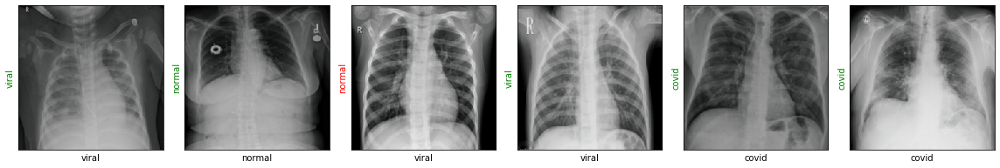

Evaluating at step 1500
Accuracy = 0.9771227452705675
Validation Loss: 0.0769, Accuracy: 0.9771
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


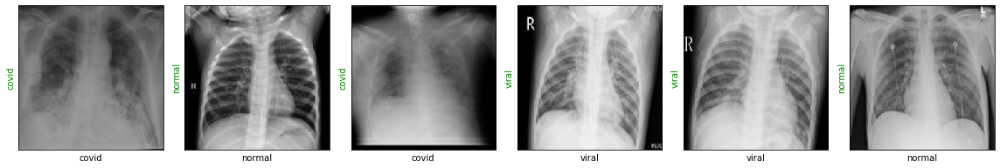

Evaluating at step 1520
Accuracy = 0.9762428508578971
Validation Loss: 0.0749, Accuracy: 0.9762
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


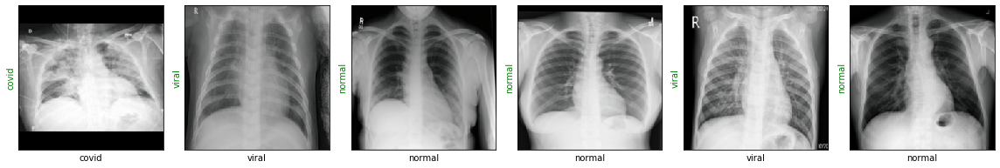

Evaluating at step 1540
Accuracy = 0.9736031676198856
Validation Loss: 0.0752, Accuracy: 0.9736
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


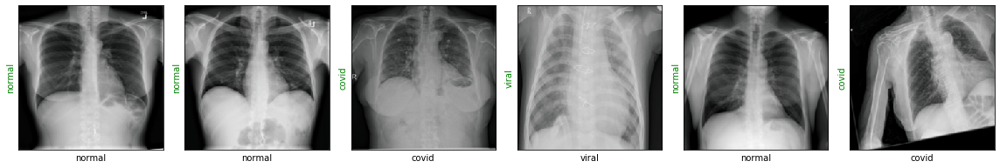

Evaluating at step 1560
Accuracy = 0.9775626924769028
Validation Loss: 0.0719, Accuracy: 0.9776
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


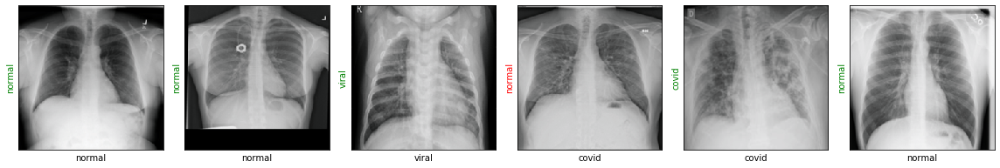

Evaluating at step 1580
Accuracy = 0.9753629564452265
Validation Loss: 0.0888, Accuracy: 0.9754
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


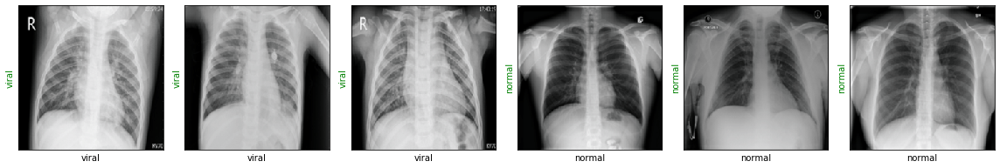

Evaluating at step 1600
Accuracy = 0.978002639683238
Validation Loss: 0.0715, Accuracy: 0.9780
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


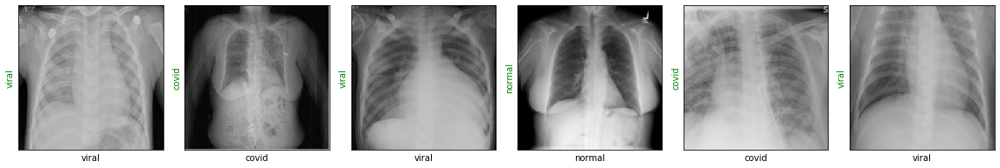

Evaluating at step 1620
Accuracy = 0.9773427188737351
Validation Loss: 0.0645, Accuracy: 0.9773
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


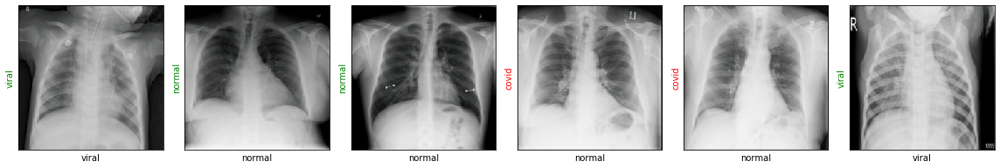

Evaluating at step 1640
Accuracy = 0.9802023757149142
Validation Loss: 0.0640, Accuracy: 0.9802
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


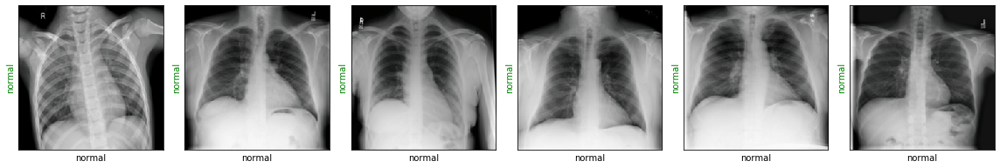

Evaluating at step 1660
Accuracy = 0.9806423229212494
Validation Loss: 0.0622, Accuracy: 0.9806
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


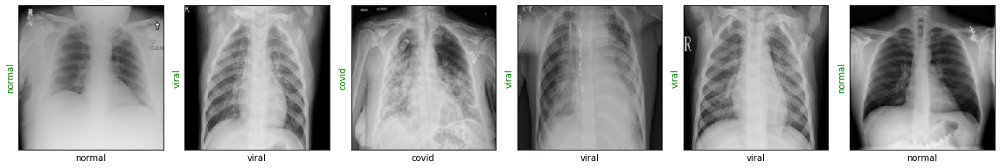

Evaluating at step 1680
Accuracy = 0.9711834579850418
Validation Loss: 0.0817, Accuracy: 0.9712
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


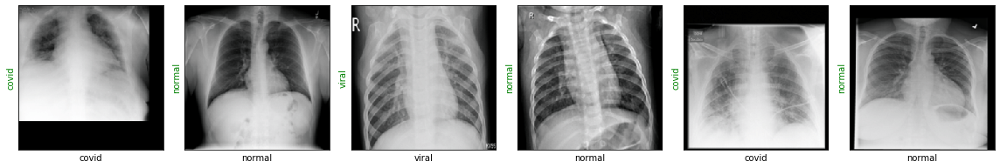

Evaluating at step 1700
Accuracy = 0.9747030356357237
Validation Loss: 0.0743, Accuracy: 0.9747
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


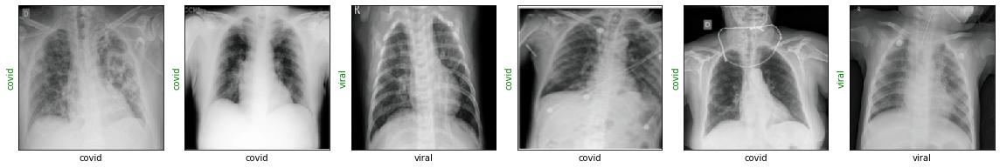

Evaluating at step 1720
Accuracy = 0.9795424549054114
Validation Loss: 0.0686, Accuracy: 0.9795
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


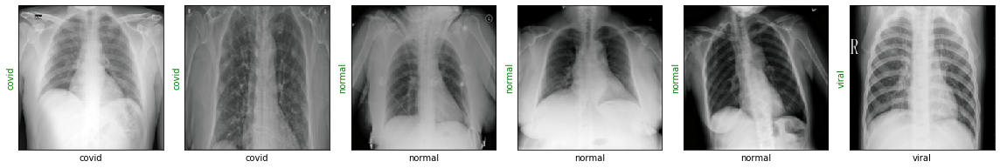

Evaluating at step 1740
Accuracy = 0.9720633523977122
Validation Loss: 0.0874, Accuracy: 0.9721
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


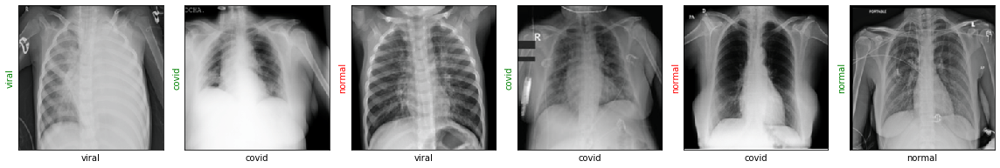

Evaluating at step 1760
Accuracy = 0.9810822701275846
Validation Loss: 0.0587, Accuracy: 0.9811
<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


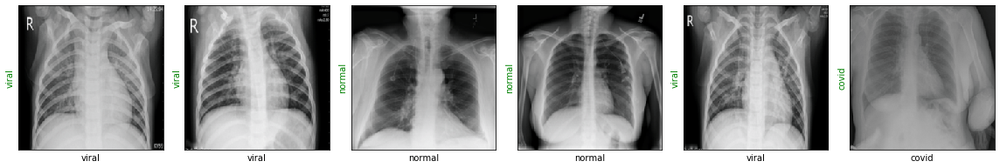

Training Loss: 0.2064
Training complete..
Wall time: 2h 39min 31s


In [24]:
%%time

train(epochs=1)

<class 'torch.Tensor'>
<class 'torch.Tensor'>
torch.Size([6, 3, 224, 224])


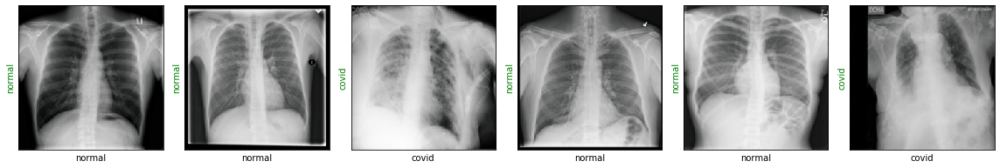

In [25]:
show_preds()

In [26]:
torch.save(resnet18, 'resnet18-98perc.pth')